In [3]:
import pandas as pd

# Load the dataset
file_path = 'C:\\Users\\User\\Downloads\\en_climate_summaries_AB_12-2019.csv'
data = pd.read_csv(file_path)

# Define the meaningful variables for modeling
meaningful_vars = ['Tm', 'DwTm', 'Tx', 'DwTx', 'P', 'DwP', 'HDD', 'CDD']

# Check if the variables exist in the dataset
missing_vars = [var for var in meaningful_vars if var not in data.columns]
if missing_vars:
    raise ValueError(f"The following variables are missing from the dataset: {missing_vars}")

# Calculate summary statistics
summary_stats = data[meaningful_vars].describe().T

# Print the summary statistics
print("Summary Statistics for Meaningful Variables:")
print(summary_stats)


Summary Statistics for Meaningful Variables:
      count        mean         std    min     25%    50%     75%     max
Tm    239.0   -8.417573    3.385142  -19.2  -10.30   -9.0   -6.35    -0.4
DwTm  239.0    0.669456    2.750773    0.0    0.00    0.0    0.00    25.0
Tx    239.0    5.817155    2.554663   -4.4    4.35    5.5    7.35    14.7
DwTx  239.0    0.648536    2.609354    0.0    0.00    0.0    0.00    25.0
P     229.0   11.118341    9.390926    1.2    6.50    9.1   11.80    68.8
DwP   229.0    2.462882    5.203295    0.0    0.00    0.0    2.00    30.0
HDD   239.0  801.361925  127.085742  175.9  730.75  829.6  867.90  1153.5
CDD   239.0    0.000000    0.000000    0.0    0.00    0.0    0.00     0.0


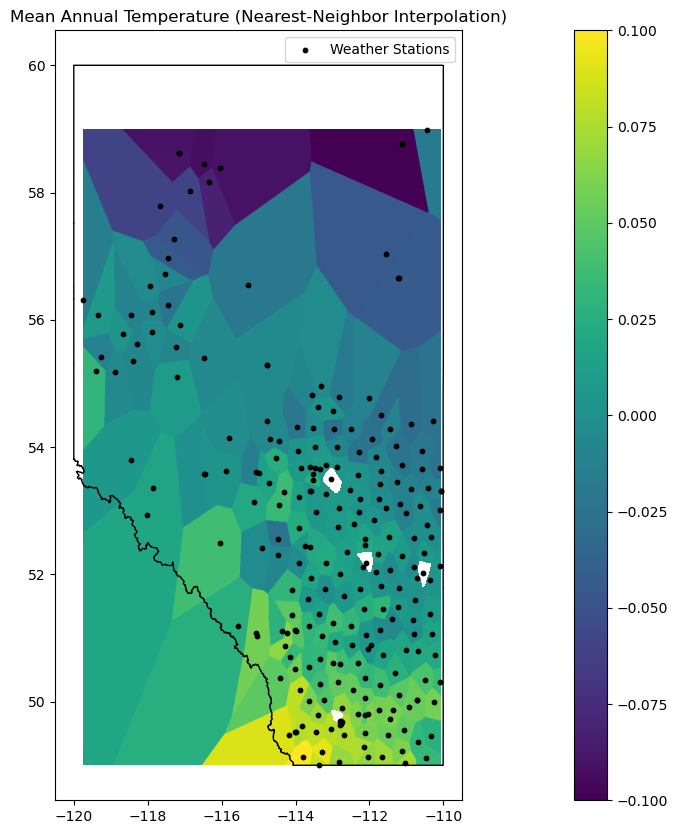

In [4]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.cm as cm
from scipy.interpolate import griddata
from shapely.geometry import Point, Polygon
from matplotlib import gridspec
from rasterio.plot import show

# Step 1: Load the CSV file and extract necessary columns
file_path = 'C:\\Users\\User\\Downloads\\en_climate_summaries_AB_12-2019.csv'
data = pd.read_csv(file_path)

if not {'Lat', 'Long', 'Tm'}.issubset(data.columns):
    raise ValueError("Required columns ('Lat', 'Long', 'Tm') are missing.")

# Convert to GeoDataFrame for geospatial operations
data = gpd.GeoDataFrame(
    data,
    geometry=gpd.points_from_xy(data.Long, data.Lat),
    crs="EPSG:4326",
)

# Step 2: Create a grid for interpolation
x_min, x_max = data['Long'].min(), data['Long'].max()
y_min, y_max = data['Lat'].min(), data['Lat'].max()

# Define grid resolution
grid_res = 0.01  # Degrees
grid_x, grid_y = np.meshgrid(
    np.arange(x_min, x_max, grid_res),
    np.arange(y_min, y_max, grid_res)
)

# Step 3: Perform Nearest-Neighbor Interpolation
points = data[['Long', 'Lat']].values
values = data['Tm'].values
grid_z_nn = griddata(points, values, (grid_x, grid_y), method='nearest')

# Step 4: Load the shapefile for boundary
shapefile_path = r"C:\Users\User\OneDrive\Desktop\lab5shape.shp"
boundary = gpd.read_file(shapefile_path)

# Step 5: Visualize the Nearest-Neighbor Interpolation
norm = mpl.colors.Normalize(vmin=values.min(), vmax=values.max(), clip=True)
mapper = cm.ScalarMappable(norm=norm, cmap=cm.viridis)

# Create the figure and subplots
fig = plt.figure(figsize=(10, 10))
gs = gridspec.GridSpec(14, 10)
ax_cb = plt.subplot2grid((14, 20), (0, 15), colspan=1, rowspan=14)
ax_map = plt.subplot2grid((14, 20), (0, 0), colspan=14, rowspan=14)

# Add colorbar
cb1 = mpl.colorbar.ColorbarBase(ax_cb, cmap=cm.viridis, norm=norm, orientation="vertical")
mpl.rcParams.update({"font.size": 10})

# Plot the interpolated temperature surface
interpolation = ax_map.imshow(
    grid_z_nn,
    extent=(x_min, x_max, y_min, y_max),
    origin='lower',
    cmap=cm.viridis,
    aspect='auto',
)

# Overlay the data points
ax_map.scatter(data.Long, data.Lat, c='black', s=10, label='Weather Stations')

# Add shapefile boundaries
boundary.plot(ax=ax_map, edgecolor="black", facecolor="none", linewidth=1)

# Title and legend
ax_map.set_title("Mean Annual Temperature (Nearest-Neighbor Interpolation)")
ax_map.legend()

plt.show()


In [5]:
# Clean data by removing NaNs to ensure consistency in lengths
data_cleaned = data.dropna(subset=['Lat', 'Long', 'Tm'])

# Points and values should come from the same dataset
points = data_cleaned[['Long', 'Lat']].values
values = data_cleaned['Tm'].values


In [6]:
print(f"Length of points: {len(points)}")
print(f"Length of values: {len(values)}")


Length of points: 239
Length of values: 239


In [7]:
# Perform interpolation
interpolated_values = griddata(points, values, points, method='nearest')

# Verify the length of interpolated values
print(f"Length of interpolated_values: {len(interpolated_values)}")

# Ensure that interpolated_values and values have the same length
if len(values) != len(interpolated_values):
    raise ValueError("Interpolated values and original values have inconsistent lengths.")


Length of interpolated_values: 239


In [8]:
from sklearn.metrics import mean_squared_error

# Calculate RMSE between original and interpolated values
rmse = np.sqrt(mean_squared_error(values, interpolated_values))

print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")


Root Mean Squared Error (RMSE): 0.0194


In [9]:
# Check for missing values
data = data.dropna(subset=['Lat', 'Long', 'Tm'])

# Ensure coordinates are within the expected range (e.g., valid latitudes and longitudes)
x_rain = data['Long'].values
y_rain = data['Lat'].values
value_rain = data['Tm'].values


In [10]:
print("Columns with NaN values:")
print(data.isnull().sum())


Columns with NaN values:
Long             0
Lat              0
Stn_Name         0
Clim_ID          0
Prov_or_Ter      0
Tm               0
DwTm             0
D              227
Tx               0
DwTx             0
Tn               0
DwTn             0
S              224
DwS            224
S%N            233
P               14
DwP             14
P%N            231
S_G            191
Pd              14
BS             239
DwBS           239
BS%            239
HDD              0
CDD              0
geometry         0
dtype: int64


In [11]:
data = data.dropna(subset=['Long', 'Lat', 'Tm'])


In [12]:
print("Remaining data points:", len(data))


Remaining data points: 239


In [13]:
lons = data['Long'].values
lats = data['Lat'].values
temps = data['Tm'].values

if len(lons) < 3:
    raise ValueError("Not enough valid data points for Kriging.")


In [14]:
# Set up and execute Kriging
from pykrige.ok import OrdinaryKriging
import numpy as np
import matplotlib.pyplot as plt

# Create Kriging model
ok = OrdinaryKriging(
    lons, lats, temps,
    variogram_model="spherical",
    verbose=False,
    enable_plotting=False
)

# Generate grid
grid_x, grid_y = np.meshgrid(
    np.linspace(lons.min(), lons.max(), 100),
    np.linspace(lats.min(), lats.max(), 100)
)

# Interpolate
grid_z, ss = ok.execute("grid", grid_x[0], grid_y[:, 0])

# Plot

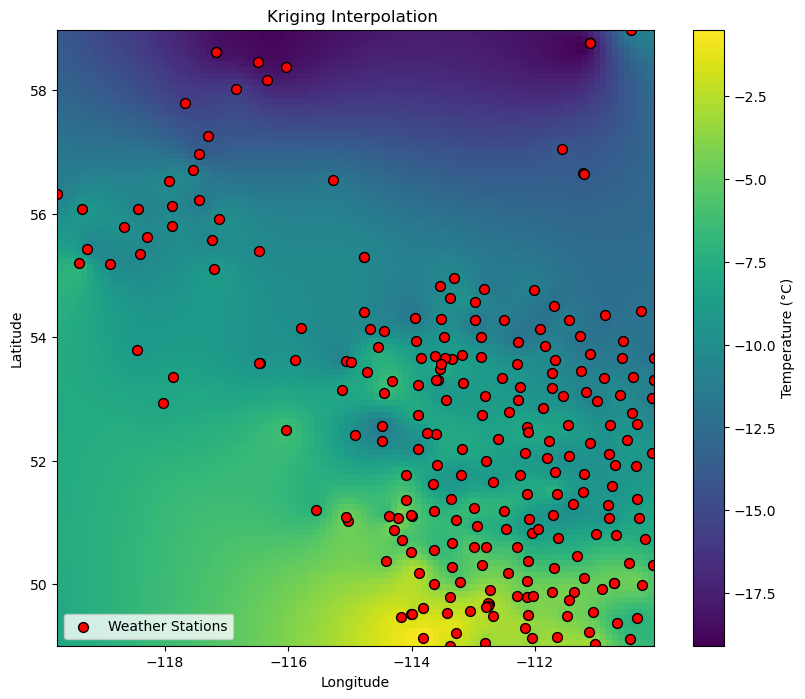

In [15]:
import matplotlib.pyplot as plt

# Plot the Kriging results
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the interpolated surface
c = ax.imshow(
    grid_z,
    extent=(lons.min(), lons.max(), lats.min(), lats.max()),
    origin="lower",
    cmap="viridis"
)
plt.colorbar(c, ax=ax, label="Temperature (°C)")  # Add colorbar

# Overlay the weather station points
ax.scatter(lons, lats, c="red", edgecolor="black", s=50, label="Weather Stations")

# Add titles and labels
ax.set_title("Kriging Interpolation ")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

# Add a legend
ax.legend()

plt.show()


In [16]:
from sklearn.metrics import mean_squared_error
import numpy as np

# Perform kriging interpolation at the original data points
z_pred, ss_pred = ok.execute("points", lons, lats)  # Predicted values at the original points

# Compute RMSE
rmse = np.sqrt(mean_squared_error(temps, z_pred))

# Print the result
print(f"Root Mean Square Error (RMSE): {rmse:.4f}")


Root Mean Square Error (RMSE): 0.0137


RMSE of IDW Interpolation: 0.0137


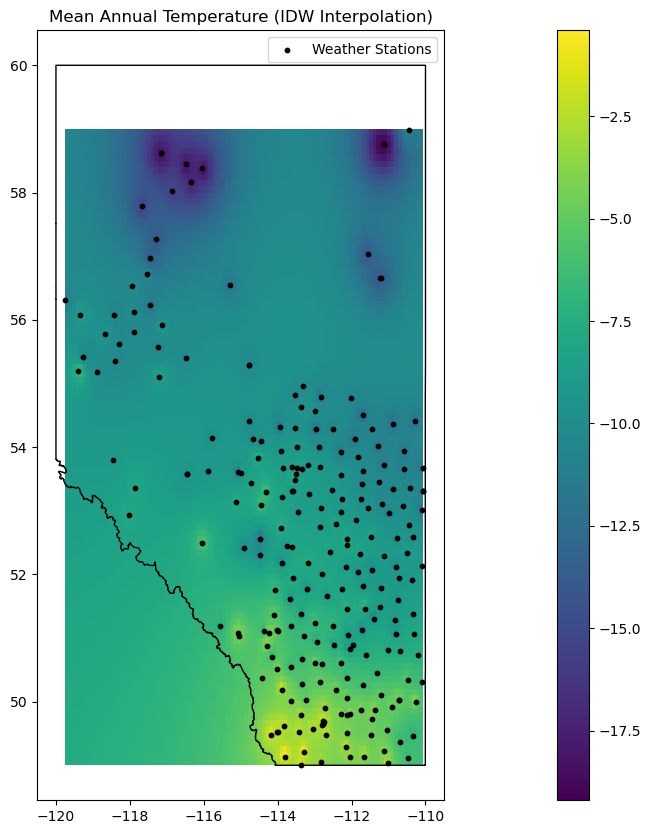

In [17]:
from sklearn.metrics import mean_squared_error

# Step 3: Perform IDW Interpolation
def idw_interpolation(points, values, grid_x, grid_y, power=2):
    """
    Perform Inverse Distance Weighting (IDW) interpolation.

    Args:
        points (array): Nx2 array of coordinates.
        values (array): N array of values at the points.
        grid_x (array): X-coordinates of the grid.
        grid_y (array): Y-coordinates of the grid.
        power (int): Power parameter for IDW.

    Returns:
        grid_z_idw: Interpolated values over the grid.
    """
    grid_z_idw = np.zeros(grid_x.shape)
    for i in range(grid_x.shape[0]):
        for j in range(grid_x.shape[1]):
            # Calculate distances
            distances = np.sqrt((points[:, 0] - grid_x[i, j])**2 + (points[:, 1] - grid_y[i, j])**2)
            # Avoid division by zero
            distances[distances == 0] = 1e-12
            # Weights for each point
            weights = 1 / (distances**power)
            # Weighted average
            grid_z_idw[i, j] = np.sum(weights * values) / np.sum(weights)
    return grid_z_idw

# Perform IDW Interpolation
grid_z_idw = idw_interpolation(points, values, grid_x, grid_y)

# Step 6: Calculate RMSE between observed and predicted points
# Predict temperature values at station locations using IDW
predicted_temps = []
for i in range(len(points)):
    distances = np.sqrt((points[:, 0] - points[i, 0])**2 + (points[:, 1] - points[i, 1])**2)
    distances[distances == 0] = 1e-12
    weights = 1 / (distances**2)
    predicted_temps.append(np.sum(weights * values) / np.sum(weights))

# Calculate RMSE
rmse = np.sqrt(mean_squared_error(values, predicted_temps))
print(f"RMSE of IDW Interpolation: {rmse:.4f}")

# Step 7: Visualize the IDW Interpolation
fig = plt.figure(figsize=(10, 10))
gs = gridspec.GridSpec(14, 10)
ax_cb = plt.subplot2grid((14, 20), (0, 15), colspan=1, rowspan=14)
ax_map = plt.subplot2grid((14, 20), (0, 0), colspan=14, rowspan=14)

# Add colorbar
norm = mpl.colors.Normalize(vmin=values.min(), vmax=values.max(), clip=True)
cb1 = mpl.colorbar.ColorbarBase(ax_cb, cmap=cm.viridis, norm=norm, orientation="vertical")
mpl.rcParams.update({"font.size": 10})

# Plot the interpolated temperature surface
interpolation = ax_map.imshow(
    grid_z_idw,
    extent=(x_min, x_max, y_min, y_max),
    origin='lower',
    cmap=cm.viridis,
    aspect='auto',
)

# Overlay the data points
ax_map.scatter(data.Long, data.Lat, c='black', s=10, label='Weather Stations')

# Add shapefile boundaries
boundary.plot(ax=ax_map, edgecolor="black", facecolor="none", linewidth=1)

# Title and legend
ax_map.set_title("Mean Annual Temperature (IDW Interpolation)")
ax_map.legend()

plt.show()


In [18]:
data

,Long,Lat,Stn_Name,Clim_ID,Prov_or_Ter,Tm,DwTm,D,Tx,DwTx,...,DwP,P%N,S_G,Pd,BS,DwBS,BS%,HDD,CDD,geometry
0,-110.868,54.367,DUPRE AGCM,3081690,AB,-12.4,0.0,NaN,5.0,0.0,...,0.0,NaN,NaN,4.0,NaN,NaN,NaN,943.8,0.0,POINT (-110.868 54.367)
1,-110.283,54.417,COLD LAKE A,3081680,AB,-12.0,0.0,2.0,4.1,0.0,...,0.0,53.0,12.0,6.0,NaN,NaN,NaN,928.8,0.0,POINT (-110.283 54.417)
2,-117.199,55.098,VALLEYVIEW AGDM,3076680,AB,-8.8,0.0,NaN,4.0,0.0,...,0.0,NaN,NaN,4.0,NaN,NaN,NaN,830.5,0.0,POINT (-117.199 55.098)
3,-116.848,58.021,TOMPKINS LANDING AGCM,3076530,AB,-15.3,0.0,NaN,2.7,0.0,...,1.0,NaN,NaN,2.0,NaN,NaN,NaN,1032.9,0.0,POINT (-116.848 58.021)
4,-118.408,55.352,TEEPEE CREEK AGCM,3076366,AB,-10.4,0.0,NaN,3.7,0.0,...,1.0,NaN,NaN,3.0,NaN,NaN,NaN,879.4,0.0,POINT (-118.408 55.352)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
238,-111.465,52.582,BELLSHILL AGCM,3010650,AB,-8.3,6.0,NaN,4.1,6.0,...,6.0,NaN,NaN,2.0,NaN,NaN,NaN,658.5,0.0,POINT (-111.465 52.582)
239,-112.279,53.917,ANDREW AGDM,3010237,AB,-11.9,3.0,NaN,4.2,3.0,...,3.0,NaN,NaN,3.0,NaN,NaN,NaN,836.3,0.0,POINT (-112.279 53.917)
240,-111.779,52.315,ALLIANCE AGCM,3010162,AB,-8.2,0.0,NaN,5.3,0.0,...,0.0,NaN,NaN,2.0,NaN,NaN,NaN,812.3,0.0,POINT (-111.779 52.315)
241,-111.181,53.113,ALBERT HALL AGCM,3010060,AB,-10.7,0.0,NaN,3.4,0.0,...,0.0,NaN,NaN,3.0,NaN,NaN,NaN,889.6,0.0,POINT (-111.181 53.113)


In [19]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import pysal.lib
from pysal.model.spreg import OLS, ML_Lag, ML_Error

# Step 1: Load CSV and Shapefile
file_path = 'C:\\Users\\User\\Downloads\\en_climate_summaries_AB_12-2019.csv'
shapefile_path = r"C:\Users\User\OneDrive\Desktop\lab5shape.shp"

# Load CSV
data = pd.read_csv(file_path)

# Ensure required columns exist
if not {'Lat', 'Long', 'Tm'}.issubset(data.columns):
    raise ValueError("Required columns ('Lat', 'Long', 'Tm') are missing.")

# Convert CSV to GeoDataFrame
data = gpd.GeoDataFrame(
    data,
    geometry=gpd.points_from_xy(data.Long, data.Lat),
    crs="EPSG:4326",
)

# Load shapefile as boundary (optional for visualization)
boundary = gpd.read_file(shapefile_path)

# Step 2: Define Dependent and Independent Variables
dependent_var = 'Tm'  # Dependent variable
independent_vars = ['DwTm', 'Tx', 'DwTx', 'DwP', 'P%N']  # Example independent variables

# Check if independent variables exist
for var in independent_vars:
    if var not in data.columns:
        raise ValueError(f"Independent variable '{var}' is missing from the dataset.")

# Drop rows with NaN in selected columns
model_data = data.dropna(subset=[dependent_var] + independent_vars).copy()

# Step 3: Create Spatial Weights Matrix
# Use KNN for spatial weights
weights = pysal.lib.weights.KNN.from_dataframe(model_data, k=4)

# Add an index column for the weights plot
model_data["index"] = model_data.index

# Visualize the spatial weights (optional)
axis = model_data.plot(edgecolor="lightgray", facecolor="none")
weights.plot(gdf=model_data, indexed_on="index", ax=axis)
axis.set_axis_off()
plt.show()

# Step 4: Prepare Data for Regression
# Convert dependent and independent variables to numpy arrays
y = model_data[dependent_var].values.reshape(-1, 1)
X = model_data[independent_vars].values

# Step 5: OLS Regression
ols_model = OLS(
    y, X, 
    w=weights, 
    spat_diag=True, 
    moran=True, 
    name_y=dependent_var, 
    name_x=independent_vars
)
print("OLS Regression Summary:")
print(ols_model.summary)

# Step 6: Spatial Lag Regression
lag_model = ML_Lag(
    y, X, 
    w=weights, 
    name_y=dependent_var, 
    name_x=independent_vars
)
print("\nSpatial Lag Model Summary:")
print(lag_model.summary)

# Step 7: Spatial Error Regression
err_model = ML_Error(
    y, X, 
    w=weights, 
    name_y=dependent_var, 
    name_x=independent_vars
)
print("\nSpatial Error Model Summary:")
print(err_model.summary)


ModuleNotFoundError: No module named 'pysal'

In [20]:
!pip install pysal

^C


OLS Regression Summary:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.928
Model:                            OLS   Adj. R-squared:                  0.899
Method:                 Least Squares   F-statistic:                     32.22
Date:                Mon, 16 Dec 2024   Prob (F-statistic):            0.00139
Time:                        09:18:48   Log-Likelihood:                -11.915
No. Observations:                   8   AIC:                             29.83
Df Residuals:                       5   BIC:                             30.07
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -16.5792      0

C:\Users\User\AppData\Roaming\Python\Python311\site-packages\scipy\stats\_stats_py.py:1971: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=8
  k, _ = kurtosistest(a, axis)
C:\Users\User\anaconda3\Lib\site-packages\statsmodels\regression\linear_model.py:1965: RuntimeWarning: divide by zero encountered in scalar divide
  return np.sqrt(eigvals[0]/eigvals[-1])
C:\Users\User\AppData\Roaming\Python\Python311\site-packages\scipy\stats\_stats_py.py:1971: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=8
  k, _ = kurtosistest(a, axis)
C:\Users\User\AppData\Roaming\Python\Python311\site-packages\scipy\stats\_stats_py.py:1971: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=8
  k, _ = kurtosistest(a, axis)


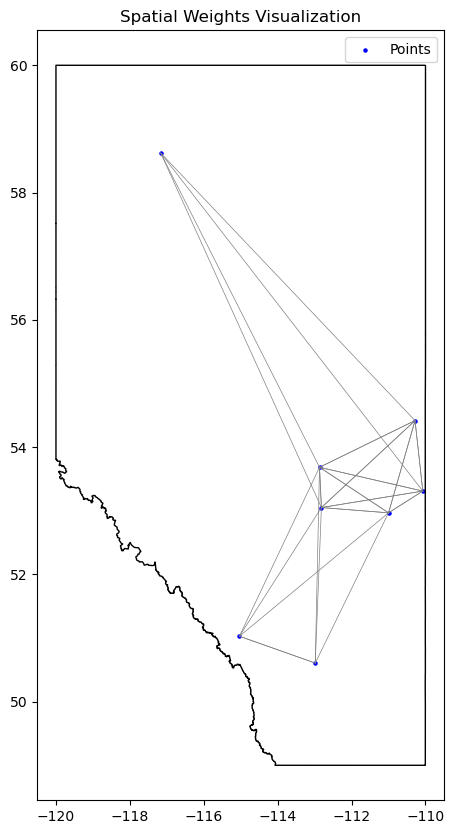

In [21]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Point
from sklearn.metrics.pairwise import haversine_distances
from statsmodels.api import OLS, add_constant
from scipy.sparse import csr_matrix

# Step 1: Load the CSV and Shapefile
file_path = 'C:\\Users\\User\\Downloads\\en_climate_summaries_AB_12-2019.csv'
shapefile_path = r"C:\Users\User\OneDrive\Desktop\lab5shape.shp"

# Load CSV and convert to GeoDataFrame
data = pd.read_csv(file_path)
if not {'Lat', 'Long', 'Tm'}.issubset(data.columns):
    raise ValueError("Required columns ('Lat', 'Long', 'Tm') are missing.")

data = gpd.GeoDataFrame(
    data,
    geometry=gpd.points_from_xy(data.Long, data.Lat),
    crs="EPSG:4326",
)

# Load the shapefile as boundary (optional)
boundary = gpd.read_file(shapefile_path)

# Step 2: Define Dependent and Independent Variables
dependent_var = 'Tm'
independent_vars = ['DwTm', 'Tx', 'DwTx', 'DwP', 'P%N']  # Example independent variables

# Check if independent variables exist
for var in independent_vars:
    if var not in data.columns:
        raise ValueError(f"Independent variable '{var}' is missing from the dataset.")

# Drop rows with NaN in selected columns
model_data = data.dropna(subset=[dependent_var] + independent_vars).copy()

# Step 3: Calculate Spatial Weights Matrix
# Get coordinates in radians for haversine calculation
coords = np.radians(model_data[['Lat', 'Long']].values)

# Compute pairwise haversine distances (in radians)
dist_matrix = haversine_distances(coords, coords) * 6371  # Convert to kilometers

# Create spatial weights (binary: 1 for neighbors within threshold, 0 otherwise)
k = 4  # Number of nearest neighbors
spatial_weights = np.zeros_like(dist_matrix)
for i, row in enumerate(dist_matrix):
    # Find indices of k-nearest neighbors (excluding self)
    nearest_indices = np.argsort(row)[1:k+1]
    spatial_weights[i, nearest_indices] = 1

# Normalize weights row-wise
spatial_weights = spatial_weights / spatial_weights.sum(axis=1, keepdims=True)

# Convert to sparse matrix
weights_sparse = csr_matrix(spatial_weights)

# Step 4: Ordinary Least Squares Regression
X = add_constant(model_data[independent_vars].values)
y = model_data[dependent_var].values

ols_model = OLS(y, X).fit()
print("OLS Regression Summary:")
print(ols_model.summary())

# Step 5: Spatial Lag Model
# Create the spatially lagged dependent variable
lagged_y = spatial_weights @ y

X_lag = np.hstack((X, lagged_y.reshape(-1, 1)))  # Add lagged dependent variable
lag_model = OLS(y, X_lag).fit()
print("\nSpatial Lag Model Summary:")
print(lag_model.summary())

# Step 6: Spatial Error Model
# Calculate spatially lagged residuals
residuals = y - ols_model.predict(X)
lagged_residuals = spatial_weights @ residuals

X_err = np.hstack((X, lagged_residuals.reshape(-1, 1)))  # Add lagged residuals
err_model = OLS(y, X_err).fit()
print("\nSpatial Error Model Summary:")
print(err_model.summary())

# Step 7: Visualization (Optional)
# Visualize spatial weights for verification
fig, ax = plt.subplots(figsize=(10, 10))
model_data.plot(ax=ax, color="blue", markersize=5, label="Points")
boundary.plot(ax=ax, edgecolor="black", facecolor="none", linewidth=1)
for i, point in enumerate(model_data.geometry):
    neighbors = np.where(spatial_weights[i] > 0)[0]
    for neighbor in neighbors:
        neighbor_point = model_data.geometry.iloc[neighbor]
        plt.plot(
            [point.x, neighbor_point.x], 
            [point.y, neighbor_point.y], 
            color="gray", linewidth=0.5
        )
ax.set_title("Spatial Weights Visualization")
plt.legend()
plt.show()


In [22]:
data

,Long,Lat,Stn_Name,Clim_ID,Prov_or_Ter,Tm,DwTm,D,Tx,DwTx,...,DwP,P%N,S_G,Pd,BS,DwBS,BS%,HDD,CDD,geometry
0,-110.868,54.367,DUPRE AGCM,3081690,AB,-12.4,0.0,NaN,5.0,0.0,...,0.0,NaN,NaN,4.0,NaN,NaN,NaN,943.8,0.0,POINT (-110.868 54.367)
1,-110.283,54.417,COLD LAKE A,3081680,AB,-12.0,0.0,2.0,4.1,0.0,...,0.0,53.0,12.0,6.0,NaN,NaN,NaN,928.8,0.0,POINT (-110.283 54.417)
2,-117.199,55.098,VALLEYVIEW AGDM,3076680,AB,-8.8,0.0,NaN,4.0,0.0,...,0.0,NaN,NaN,4.0,NaN,NaN,NaN,830.5,0.0,POINT (-117.199 55.098)
3,-116.848,58.021,TOMPKINS LANDING AGCM,3076530,AB,-15.3,0.0,NaN,2.7,0.0,...,1.0,NaN,NaN,2.0,NaN,NaN,NaN,1032.9,0.0,POINT (-116.848 58.021)
4,-118.408,55.352,TEEPEE CREEK AGCM,3076366,AB,-10.4,0.0,NaN,3.7,0.0,...,1.0,NaN,NaN,3.0,NaN,NaN,NaN,879.4,0.0,POINT (-118.408 55.352)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
238,-111.465,52.582,BELLSHILL AGCM,3010650,AB,-8.3,6.0,NaN,4.1,6.0,...,6.0,NaN,NaN,2.0,NaN,NaN,NaN,658.5,0.0,POINT (-111.465 52.582)
239,-112.279,53.917,ANDREW AGDM,3010237,AB,-11.9,3.0,NaN,4.2,3.0,...,3.0,NaN,NaN,3.0,NaN,NaN,NaN,836.3,0.0,POINT (-112.279 53.917)
240,-111.779,52.315,ALLIANCE AGCM,3010162,AB,-8.2,0.0,NaN,5.3,0.0,...,0.0,NaN,NaN,2.0,NaN,NaN,NaN,812.3,0.0,POINT (-111.779 52.315)
241,-111.181,53.113,ALBERT HALL AGCM,3010060,AB,-10.7,0.0,NaN,3.4,0.0,...,0.0,NaN,NaN,3.0,NaN,NaN,NaN,889.6,0.0,POINT (-111.181 53.113)


In [25]:
import pandas as pd
import numpy as np

# Load the dataset
file_path = 'C:\\Users\\User\\Downloads\\en_climate_summaries_AB_12-2019.csv'
data = pd.read_csv(file_path)

# Define the meaningful variables for analysis
meaningful_vars = ['Tm', 'DwTm', 'Tx', 'DwTx', 'P', 'DwP', 'HDD', 'CDD']

# Check if the variables exist in the dataset
missing_vars = [var for var in meaningful_vars if var not in data.columns]
if missing_vars:
    raise ValueError(f"The following variables are missing from the dataset: {missing_vars}")

# Select meaningful variables
df = data[meaningful_vars]

# --- Step 1: Handle Missing Values ---
# Display missing value counts
missing_counts = df.isnull().sum()
print("\nMissing Value Counts:")
print(missing_counts)

# Fill missing values with column means (can be replaced by other imputation techniques if needed)
df.fillna(df.mean(), inplace=True)

# --- Step 2: Remove Outliers ---
# Define a function to remove outliers using the IQR method
def remove_outliers(df, col):
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[col] >= lower_bound) & (df[col] <= upper_bound)]

# Apply outlier removal for each variable
for var in meaningful_vars:
    df = remove_outliers(df, var)

# --- Step 3: Calculate Summary Statistics ---
summary_stats = df.describe().T
summary_stats['median'] = df.median()  # Add median for better central tendency analysis
summary_stats['range'] = summary_stats['max'] - summary_stats['min']  # Calculate range
summary_stats['skewness'] = df.skew()  # Calculate skewness to assess data symmetry
summary_stats['kurtosis'] = df.kurtosis()  # Calculate kurtosis to assess peak and tail behavior

# Display summary statistics
print("\nAdvanced Summary Statistics:")
print(summary_stats)

# --- Step 4: Insights for Conclusions ---
print("\nKey Insights:")
for col in meaningful_vars:
    print(f"\n--- {col} ---")
    print(f"Mean: {summary_stats.loc[col, 'mean']:.2f}")
    print(f"Median: {summary_stats.loc[col, 'median']:.2f}")
    print(f"Skewness: {summary_stats.loc[col, 'skewness']:.2f} (Skewed {'right' if summary_stats.loc[col, 'skewness'] > 0 else 'left'})")
    print(f"Kurtosis: {summary_stats.loc[col, 'kurtosis']:.2f} ({'Leptokurtic' if summary_stats.loc[col, 'kurtosis'] > 3 else 'Platykurtic' if summary_stats.loc[col, 'kurtosis'] < 3 else 'Mesokurtic'})")



Missing Value Counts:
Tm       4
DwTm     4
Tx       4
DwTx     4
P       14
DwP     14
HDD      4
CDD      4
dtype: int64

Advanced Summary Statistics:
      count        mean        std    min    25%    50%         75%     max  \
Tm    161.0   -7.905590   3.067088  -15.3  -10.0   -8.6   -5.200000    -1.1   
DwTm  161.0    0.000000   0.000000    0.0    0.0    0.0    0.000000     0.0   
Tx    161.0    6.327950   2.280247    2.2    4.6    5.7    8.100000    11.9   
DwTx  161.0    0.000000   0.000000    0.0    0.0    0.0    0.000000     0.0   
P     161.0    9.123727   3.242562    1.2    6.7    9.2   11.118341    17.9   
DwP   161.0    0.723942   1.349562    0.0    0.0    0.0    1.000000     6.0   
HDD   161.0  802.999379  95.097862  593.1  720.6  823.2  868.400000  1033.4   
CDD   161.0    0.000000   0.000000    0.0    0.0    0.0    0.000000     0.0   

      median  range  skewness  kurtosis  
Tm      -8.6   14.2  0.183143 -0.486146  
DwTm     0.0    0.0  0.000000  0.000000  
Tx      

C:\Users\User\AppData\Local\Temp\ipykernel_70380\451699568.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.fillna(df.mean(), inplace=True)



Correlation of Tm with Other Variables:
Tm      1.000000
Tx      0.847488
DwP     0.156559
P      -0.049147
HDD    -0.999956
DwTm         NaN
DwTx         NaN
CDD          NaN
Name: Tm, dtype: float64


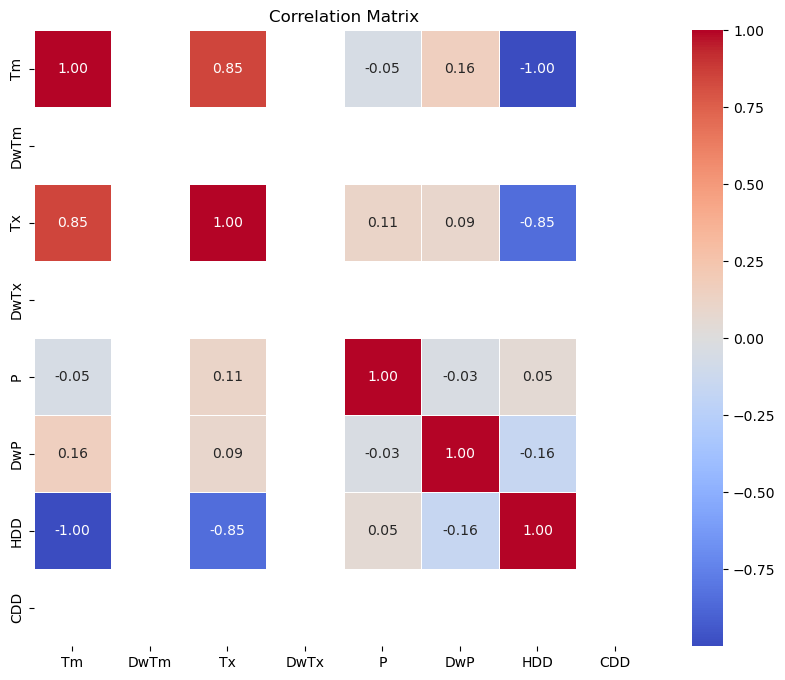

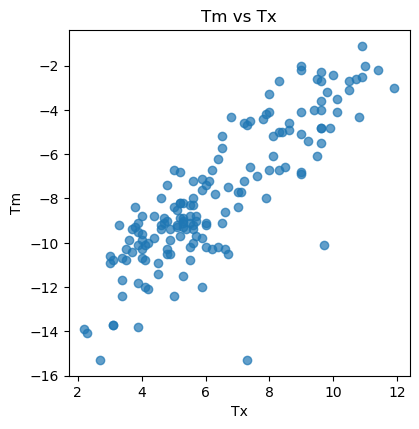

In [45]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# --- Correlation Analysis ---
correlation_matrix = df.corr()  # Calculate correlation matrix

# Extract correlations of Tm with other variables and sort them in descending order
tm_correlation = correlation_matrix['Tm'].sort_values(ascending=False)

print("\nCorrelation of Tm with Other Variables:")
print(tm_correlation)

# --- Visualize the Correlation Matrix ---
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

# --- Visualize Top Correlations with Tm ---
top_correlations = tm_correlation[tm_correlation > 0.5]  # Variables with strong positive correlation
bottom_correlations = tm_correlation[tm_correlation < -0.5]  # Variables with strong negative correlation

# Create a figure for scatter plots
plt.figure(figsize=(12, 8))
for idx, col in enumerate(top_correlations.index):
    if col != 'Tm':  # Avoid plotting Tm against itself
        plt.subplot(2, 3, idx+1)
        plt.scatter(df[col], df['Tm'], alpha=0.7)
        plt.title(f"Tm vs {col}")
        plt.xlabel(col)
        plt.ylabel("Tm")
plt.tight_layout()
plt.show()


Original Shapefile CRS: EPSG:3400


C:\Users\User\AppData\Local\Temp\ipykernel_70380\3477443475.py:36: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()


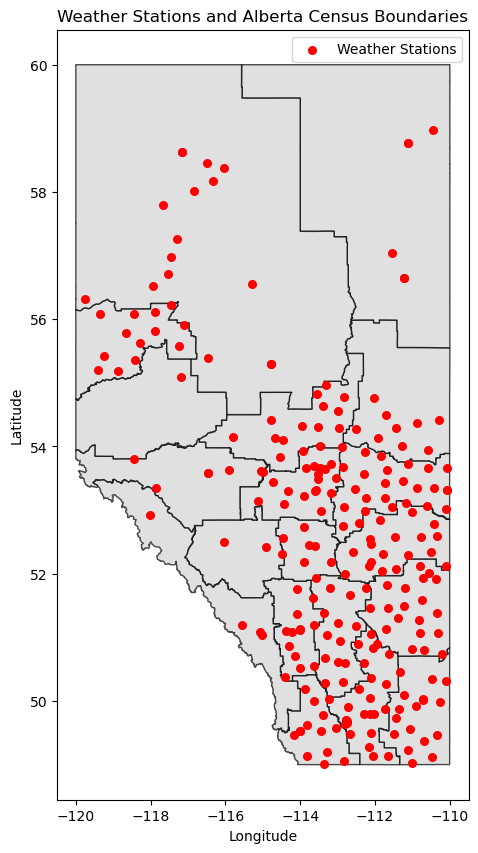

In [32]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV and Shapefile
csv_path = 'C:\\Users\\User\\Downloads\\en_climate_summaries_AB_12-2019.csv'
shapefile_path = r"C:\Users\User\Downloads\Alberta_Census_Boundaries_SHP\Data\AB_CD_2021.shp"

# Load CSV into pandas DataFrame
data = pd.read_csv(csv_path)

# Load the Shapefile into GeoDataFrame
boundary = gpd.read_file(shapefile_path)

# Check the CRS of the shapefile and reproject it to EPSG:4326 (WGS84 for lat/lon)
print("Original Shapefile CRS:", boundary.crs)
boundary = boundary.to_crs(epsg=4326)

# Convert CSV data to GeoDataFrame for spatial plotting
gdf = gpd.GeoDataFrame(
    data, 
    geometry=gpd.points_from_xy(data['Long'], data['Lat']), 
    crs="EPSG:4326"
)

# Plot the shapefile and the point data
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# Plot shapefile boundaries
boundary.plot(ax=ax, color='lightgrey', edgecolor='black', alpha=0.7, label='Regions')

# Overlay point data
gdf.plot(ax=ax, color='red', markersize=30, label='Weather Stations')

# Add legend and title
plt.legend()
plt.title("Weather Stations and Alberta Census Boundaries")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()


In [36]:
import geopandas as gpd
import pandas as pd
import plotly.express as px
# Reproject shapefile to match CRS
boundary = boundary.to_crs(epsg=4326)

# Spatial Join: Combine points with boundaries based on spatial intersection
gdf = gpd.GeoDataFrame(
    data, 
    geometry=gpd.points_from_xy(data['Long'], data['Lat']),
    crs="EPSG:4326"
)
region_data = gpd.sjoin(gdf, boundary, how="inner", predicate="intersects")


# Aggregate mean temperature for each region
choropleth_data = region_data.groupby('CDUID')['Tm'].mean().reset_index()
choropleth_data.columns = ['id', 'MeanTemperature']

# Plotly Choropleth Map
fig = px.choropleth(
    choropleth_data,
    geojson=boundary,  # Shapefile as GeoJSON
    locations="id",  # Region ID
    featureidkey="properties.CDUID",  # Match with boundary property
    color="MeanTemperature",  # Thematic variable
    hover_name="id",
    title="Thematic Map: Mean Temperature by Region",
    color_continuous_scale="Viridis",
)
fig.update_geos(fitbounds="locations", visible=False)
fig.show()


In [37]:
import plotly.express as px

# Ensure you have a Mapbox token
px.set_mapbox_access_token("YOUR_MAPBOX_ACCESS_TOKEN")

# Create a heat map of temperature intensity
fig = px.density_mapbox(
    region_data,
    lat=region_data.geometry.y,
    lon=region_data.geometry.x,
    z="Tm",
    radius=20,
    center={"lat": region_data.geometry.y.mean(), "lon": region_data.geometry.x.mean()},
    zoom=6,
    mapbox_style="carto-positron",
    title="Heat Map of Mean Temperature"
)
fig.show()


In [44]:
import pandas as pd
import plotly.express as px

# Clean the data: Replace NaNs with a default value (e.g., 0)
data['size'] = data['Tm'].abs().fillna(0)

# Alternatively, drop rows with NaN 'size'
data = data.dropna(subset=['size'])

# Simple Proportional Symbol Map
fig = px.scatter_geo(
    data,
    lon='Long', 
    lat='Lat',
    size='size',  # Size is proportional to 'Tm'
    color='Tm',   # Color by temperature
    hover_name='Stn_Name',
    title="Proportional Symbol Map - Weather Stations",
    projection="natural earth"
)

fig.show()


C:\Users\User\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\User\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\User\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\User\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\User\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_i

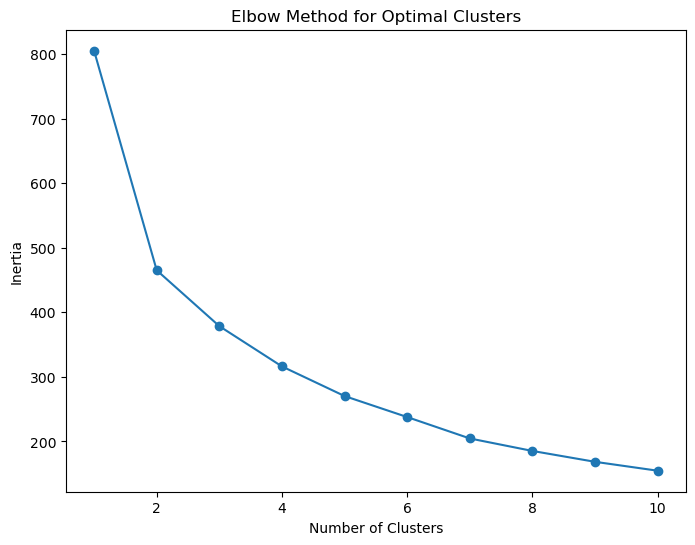

C:\Users\User\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning




Cluster Centroids:
         Tm  DwTm        Tx  DwTx         P       DwP         HDD  CDD
0 -8.442105   0.0  5.657895   0.0  9.281407  3.563319  819.510526  0.0
1 -9.802174   0.0  4.975000   0.0  8.950199  0.157205  861.793478  0.0
2 -4.212000   0.0  9.072000   0.0  9.383100  0.687773  688.544000  0.0


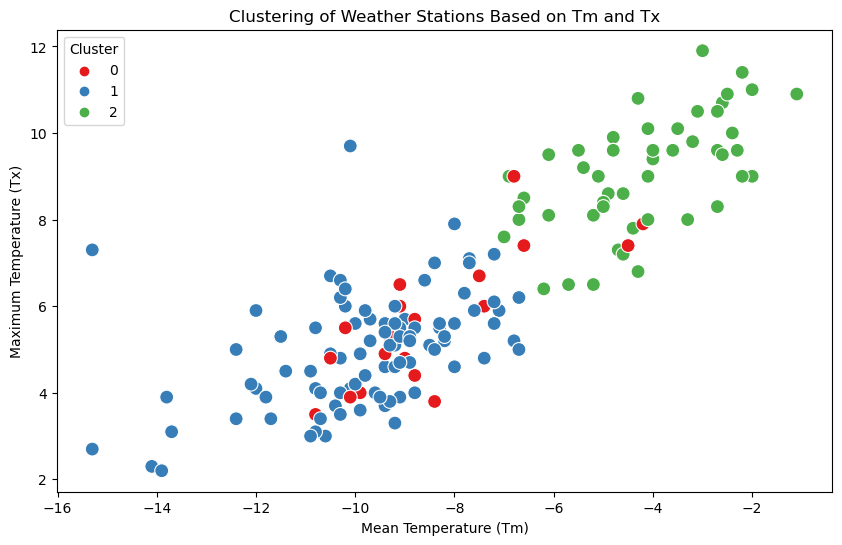

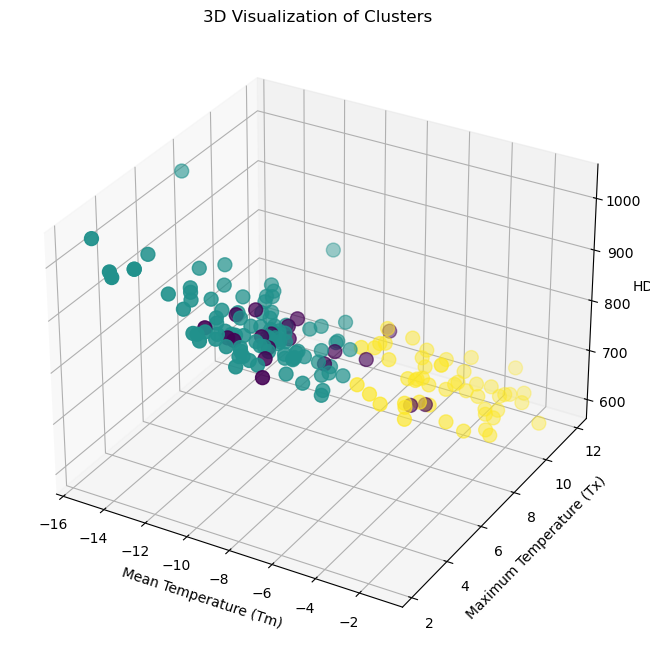


Cluster Profile:
               Tm  DwTm        Tx  DwTx         P       DwP         HDD  CDD
Cluster                                                                     
0       -8.442105   0.0  5.657895   0.0  9.281407  3.563319  819.510526  0.0
1       -9.802174   0.0  4.975000   0.0  8.950199  0.157205  861.793478  0.0
2       -4.212000   0.0  9.072000   0.0  9.383100  0.687773  688.544000  0.0


C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

C:\Users\User\anaconda3\Lib\site-package

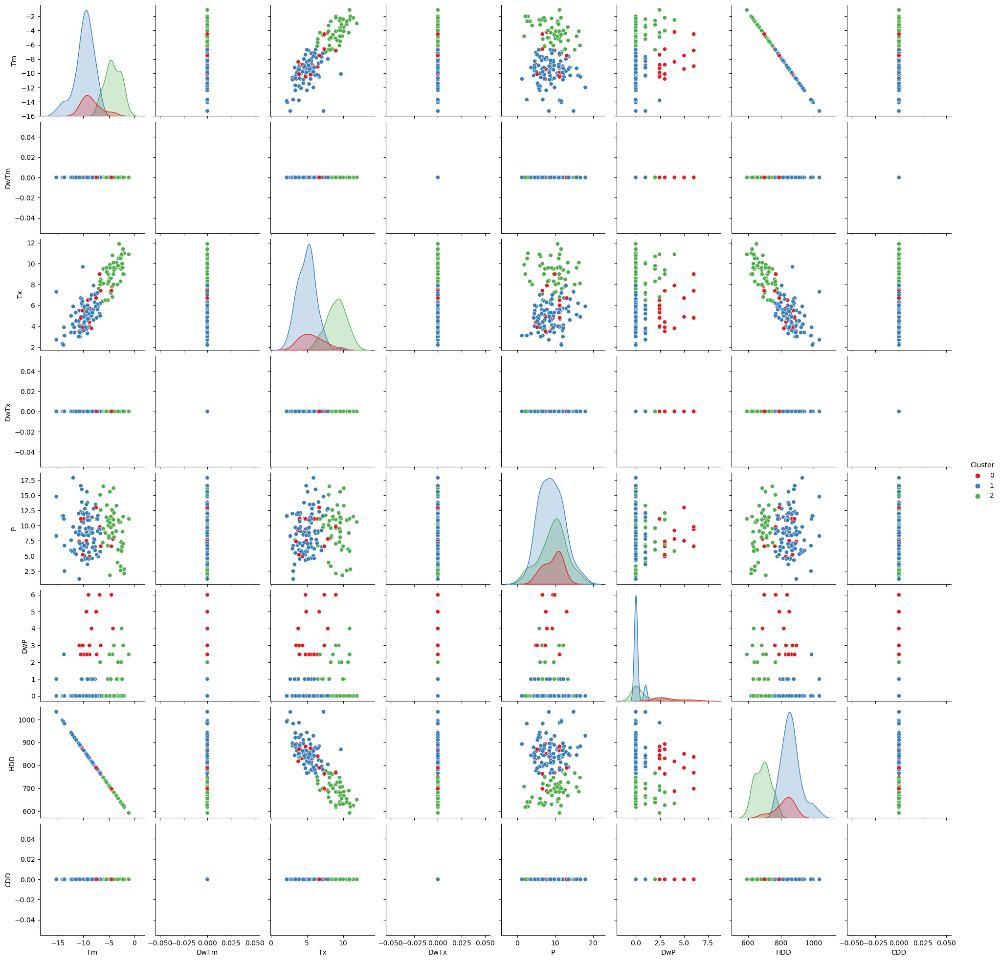

In [47]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D

# --- Step 1: Load and Preprocess Data ---
# Assuming 'df' is your dataframe loaded from the CSV file
# Example: df = pd.read_csv("path_to_file.csv")

# Select only the meaningful variables for clustering
meaningful_vars = ['Tm', 'DwTm', 'Tx', 'DwTx', 'P', 'DwP', 'HDD', 'CDD']
data = df[meaningful_vars]

# Handle missing values by filling with the column mean
data = data.fillna(data.mean())

# Standardize the data to ensure features are on the same scale
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data)

# --- Step 2: Determine Optimal Number of Clusters using Elbow Method ---
inertia = []
for i in range(1, 11):  # Try with cluster numbers from 1 to 10
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(scaled_data)
    inertia.append(kmeans.inertia_)

# Plot the Elbow Curve to find the optimal number of clusters
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), inertia, marker='o')
plt.title('Elbow Method for Optimal Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.show()

# Based on the Elbow Method, let's assume the optimal number of clusters is 3
# --- Step 3: Apply K-means Clustering ---
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(scaled_data)

# Add the cluster labels to the original dataframe
df['Cluster'] = clusters

# --- Step 4: Analyze the Clusters ---
# Print the centroid of each cluster (inverse transforming to original scale)
centroids = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns=meaningful_vars)
print("\nCluster Centroids:")
print(centroids)

# --- Step 5: Visualize the Clusters ---
# Scatter plot of clusters (Tm vs Tx as an example)
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='Tm', y='Tx', hue='Cluster', palette='Set1', s=100)
plt.title('Clustering of Weather Stations Based on Tm and Tx')
plt.xlabel('Mean Temperature (Tm)')
plt.ylabel('Maximum Temperature (Tx)')
plt.legend(title='Cluster')
plt.show()

# --- Step 6: 3D Visualization of Clusters (Optional) ---
# Visualizing clusters in 3D (example with three features: Tm, Tx, and HDD)
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['Tm'], df['Tx'], df['HDD'], c=df['Cluster'], cmap='viridis', s=100)
ax.set_xlabel('Mean Temperature (Tm)')
ax.set_ylabel('Maximum Temperature (Tx)')
ax.set_zlabel('HDD')

plt.title('3D Visualization of Clusters')
plt.show()

# --- Step 7: Cluster Profiling ---
cluster_profile = df.groupby('Cluster')[meaningful_vars].mean()
print("\nCluster Profile:")
print(cluster_profile)

# --- Step 8: Optional - Visualize Pairwise Relationships ---
# Pairplot of the clusters to explore relationships between different features
sns.pairplot(df[meaningful_vars + ['Cluster']], hue='Cluster', palette='Set1')
plt.show()


C:\Users\User\anaconda3\Lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


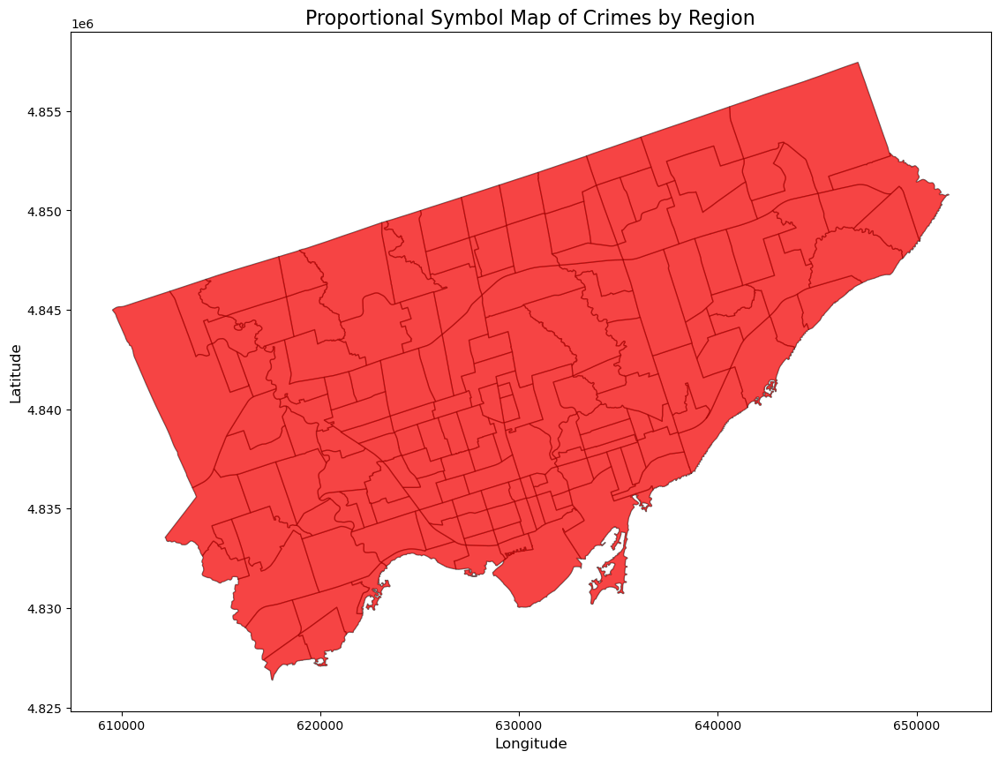

In [1]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# File paths
csv_path = r"C:\Users\User\Downloads\Major_Crime_Indicators_Open_Data_7078712861615598701 (1).csv"
shapefile_path = r"C:\Users\User\Downloads\Neighbourhood_Crime_Rates_Open_Data_-7850543563477888236\NEIGHBOURHOOD_CRIME_RATE_OPEN_DATA.shp"

# Load CSV data
crime_df = pd.read_csv(csv_path)

# Create GeoDataFrame from the CSV file
geometry = [Point(xy) for xy in zip(crime_df['LONG_WGS84'], crime_df['LAT_WGS84'])]
crime_gdf = gpd.GeoDataFrame(crime_df, geometry=geometry, crs="EPSG:4326")

# Load the shapefile for the boundary
boundary_gdf = gpd.read_file(shapefile_path)

# Filter columns to include only crime-related data
crime_columns = [
    col for col in boundary_gdf.columns 
    if not col.lower() in ['area_name', 'hood_id', 'population', 'geometry']
]

# Calculate total crimes for each region
boundary_gdf['Total_Crimes'] = boundary_gdf[crime_columns].sum(axis=1)

# Normalize crime data for proportional symbol size
boundary_gdf['Crime_Scale'] = boundary_gdf['Total_Crimes'] / boundary_gdf['Total_Crimes'].max() * 100

# Plot the proportional symbol map
fig, ax = plt.subplots(1, 1, figsize=(15, 10))

# Plot regions
boundary_gdf.plot(ax=ax, color='lightgrey', edgecolor='black', alpha=0.6)

# Add proportional symbols
boundary_gdf.plot(
    ax=ax,
    color='red',
    markersize=boundary_gdf['Crime_Scale'],  # Use scaled values for symbol size
    alpha=0.7,
)

# Add titles and labels
ax.set_title("Proportional Symbol Map of Crimes by Region", fontsize=16)
ax.set_xlabel("Longitude", fontsize=12)
ax.set_ylabel("Latitude", fontsize=12)

# Display the plot
plt.show()
